In [67]:
import pandas as pd
import seaborn as sn
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as stats
import matplotlib as mpl

from termcolor import colored

# Pare ustawien dla kolorow i wykresow z wykladow:

light="#FFFCDC"
light_highlight="#FEF590"
mid="#FDED2A"
mid_highlight="#f0dc05"
dark="#EECA02"
dark_highlight="#BB9700"
green="#00FF00"
blue="#0000FF"
red="#FF0000"
light_grey="#DDDDDD"

plt.style.context('seaborn-white')
mpl.rcParams['figure.dpi']= 200

In [68]:
# Teraz zaladuje wszystkie potrzebne zabawki ze "stana"
import pystan
import stan_utility

# Teraz stworze plik z modelem multiwymiarowym normalnym dla stana, zeby mogl ladnie policzyc. Mozna napisac plik i go zapisac po ludzku, ale ja sobie napisalem w pythonie.

Multi_normal_stan_file = open("Multi_normal.stan", "w")

Multi_normal_stan_file.write("\
data \n\
{\n\
    vector[2] mu; //location vector\n\
    matrix[2,2] Sigma; //covariance matrix\n\
}\n\
\n\
parameters \n\
{\n\
    vector[2] wyjscie;\n\
}\n\
\n\
model {\n\
    wyjscie ~ multi_normal(mu, Sigma);\n\
}\n\
")

Multi_normal_stan_file.close()

In [69]:
# Tak jak na wykladzie, kompiluje model:
# TO MOZE POTRWAC!

model_multi_normal = stan_utility.compile_model('Multi_normal.stan')

#Jakies 30 sekund i 1,6GB RAMu

Using cached StanModel


In [70]:
# Teraz sobie pozgadujemy:
# Musi byc dict bo takie sa wymagania stana, tak musi byc i tyle:
mean=[0,0]
cov=[(1, 0.5), (0.5, 1)]
data = {'mu':mean, 'Sigma':cov}

numberOfIterations = 10000

# No i tutaj robimy sobie sampling, zeby zobaczyc jakie dostaniemy wyniki
sampling_data = model_multi_normal.sampling(data = data, seed = 11062020, iter = numberOfIterations)

In [71]:
# Wyciagamy wyniki z naszego samplowania:

results_model_multi_normal = sampling_data.extract()

print(colored("Results: ", 'yellow'))
print(results_model_multi_normal)
print("\n -----------------------------------------------------------------------\n")
print(colored("Summary: ", 'yellow'))
print(sampling_data.stansummary())

Results: 
OrderedDict([('wyjscie', array([[ 0.75428702,  1.4299771 ],
       [ 0.12106283,  0.09830396],
       [ 0.87711809,  1.20205232],
       ...,
       [ 0.11822461, -0.00222896],
       [-0.3123784 , -1.00730945],
       [-2.06886053, -0.91568088]])), ('lp__', array([-1.02344683, -0.00827928, -0.77328273, ..., -0.00949703,
       -0.53172725, -2.14949289]))])

 -----------------------------------------------------------------------

Summary: 
Inference for Stan model: anon_model_e0a42bfee44171c4330b9cb2e74061f9.
4 chains, each with iter=10000; warmup=5000; thin=1; 
post-warmup draws per chain=5000, total post-warmup draws=20000.

             mean se_mean     sd   2.5%    25%    50%    75%  97.5%  n_eff   Rhat
wyjscie[1]-2.4e-3    0.01    1.0  -1.96  -0.67-9.5e-3   0.67   1.99   9325    1.0
wyjscie[2] 8.1e-3    0.01    1.0  -1.92  -0.67-8.3e-3   0.69   2.01   9207    1.0
lp__         -1.0    0.01   1.01  -3.71  -1.38  -0.68  -0.28  -0.03   8858    1.0

Samples were drawn using 

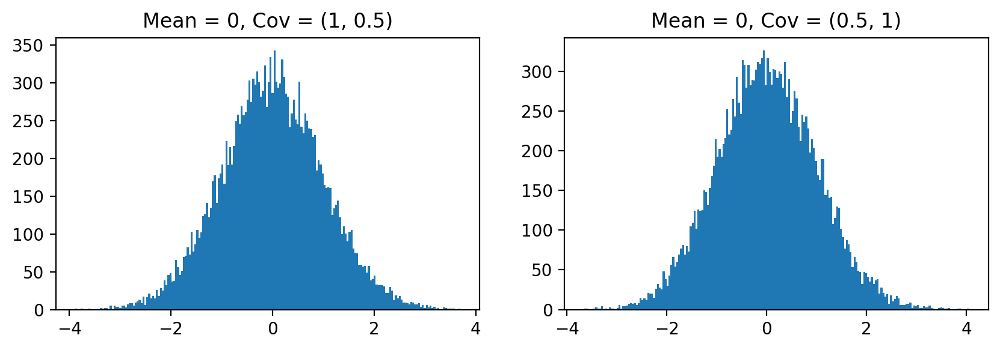

In [72]:
# A teraz wyswietle sobie histogram:

plt.figure(figsize=(10,3))
plt.subplot(1,2,1)
plt.title("Mean = 0, Cov = (1, 0.5)")
Histogram = plt.hist(results_model_multi_normal['wyjscie'][:,0], bins=200)
plt.subplot(1,2,2)
plt.title("Mean = 0, Cov = (0.5, 1)")
Histogram = plt.hist(results_model_multi_normal['wyjscie'][:,1], bins=200)

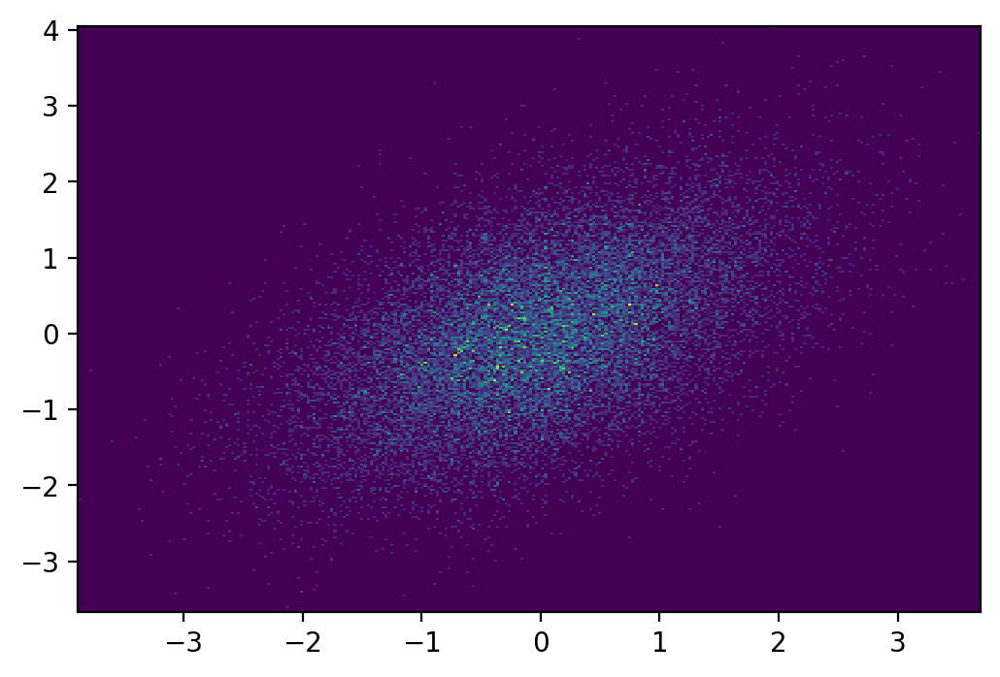

In [73]:
# A teraz nowosc - histogram 2D czyli takie fajne cos co ladnie prezentuje rozklad prawie jak mglawice gwiazd czy jak to sie tam zwie:

Histogram2D = plt.hist2d(results_model_multi_normal['wyjscie'][:,0], results_model_multi_normal['wyjscie'][:,1], bins = 300)

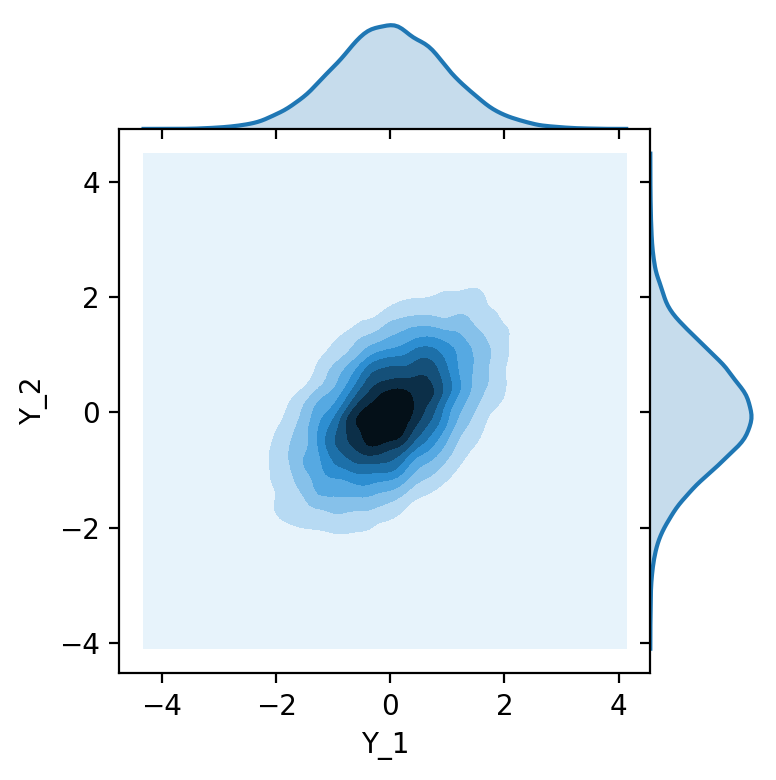

In [74]:
# A teraz jeszcze wieksza nowosc bo bedzie kernel density estimation! :

x1, x2 = pd.Series(results_model_multi_normal['wyjscie'][:,0], name="Y_1"), pd.Series(results_model_multi_normal['wyjscie'][:,1], name="Y_2")

sn.jointplot(x1, x2, kind='kde', height=4, space=0)

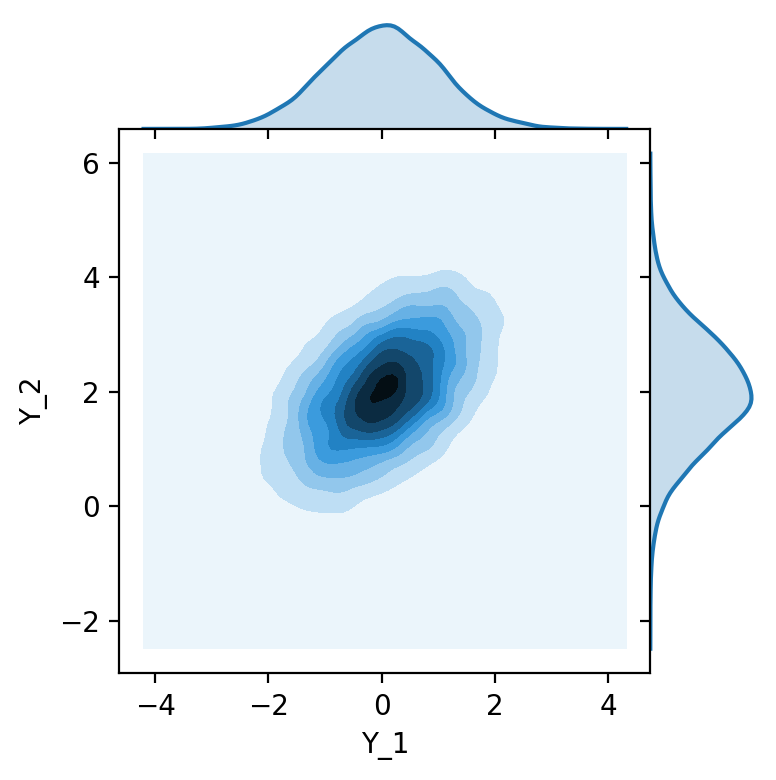

In [75]:
mean=[0,2]
cov=[(1, 0.5), (0.5, 1)]
data = {'mu':mean, 'Sigma':cov}

numberOfIterations = 10000

# No i tutaj robimy sobie sampling, zeby zobaczyc jakie dostaniemy wyniki
sampling_data = model_multi_normal.sampling(data = data, seed = 11062020, iter = numberOfIterations)

results_model_multi_normal = sampling_data.extract()

x1, x2 = pd.Series(results_model_multi_normal['wyjscie'][:,0], name="Y_1"), pd.Series(results_model_multi_normal['wyjscie'][:,1], name="Y_2")

sn.jointplot(x1, x2, kind='kde', height=4, space=0)

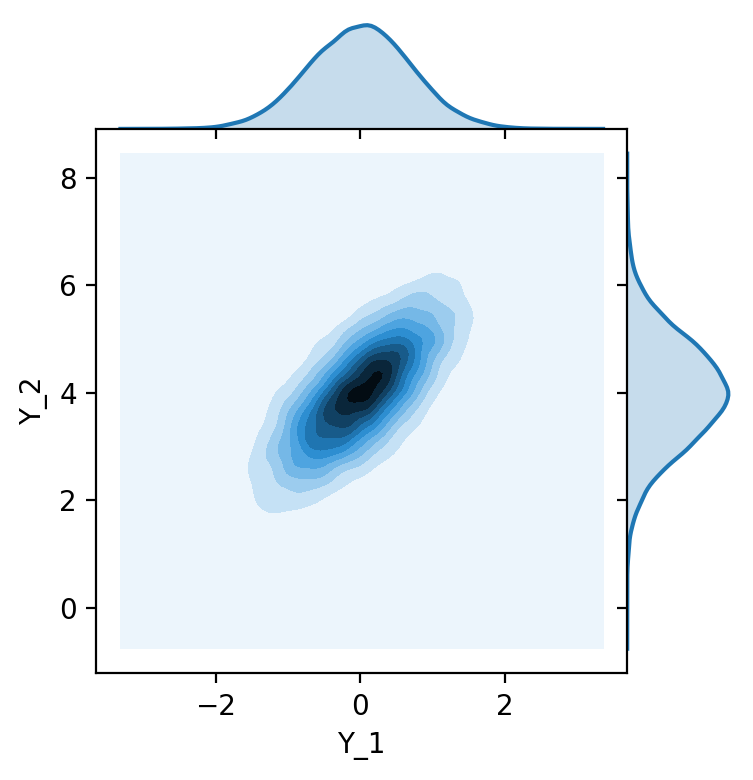

In [76]:
mean=[0,4]
cov=[(0.5, 0.5), (0.5, 1)]
data = {'mu':mean, 'Sigma':cov}

numberOfIterations = 10000

# No i tutaj robimy sobie sampling, zeby zobaczyc jakie dostaniemy wyniki
sampling_data = model_multi_normal.sampling(data = data, seed = 11062020, iter = numberOfIterations)

results_model_multi_normal = sampling_data.extract()

x1, x2 = pd.Series(results_model_multi_normal['wyjscie'][:,0], name="Y_1"), pd.Series(results_model_multi_normal['wyjscie'][:,1], name="Y_2")

sn.jointplot(x1, x2, kind='kde', height=4, space=0)

In [77]:
# Teraz stworze plik z modelem multiwymiarowym normalnym dla stana (wymiar N)

N_Multi_normal_stan_file = open("N_Multi_normal.stan", "w")

N_Multi_normal_stan_file.write("\
data \n\
{\n\
    int <lower=0> N;        //Number of dimensions\n\
    vector[N] mu;           //location vector\n\
    matrix[N,N] Sigma;      //covariance matrix\n\
}\n\
\n\
parameters \n\
{\n\
    vector[N] wyjscie;\n\
}\n\
\n\
model {\n\
    wyjscie ~ multi_normal(mu, Sigma);\n\
}\n\
")

N_Multi_normal_stan_file.close()

In [78]:
# Tak jak na wykladzie, kompiluje model:
# TO MOZE POTRWAC!

model_N_multi_normal = stan_utility.compile_model('N_Multi_normal.stan')

#Jakies 30 sekund i 1,6GB RAMu

Using cached StanModel


In [79]:
# Teraz sobie pozgadujemy:
# Musi byc dict bo takie sa wymagania stana, tak musi byc i tyle:
mean=[0, 0, 0]
cov=[(1, 0.5, 0.3), (0.5, 1, 0.5), (0.3, 0.5, 1)]
N = len(cov)
data = {'N':N, 'mu':mean, 'Sigma':cov}

numberOfIterations = 10000

# No i tutaj robimy sobie sampling, zeby zobaczyc jakie dostaniemy wyniki
sampling_data = model_N_multi_normal.sampling(data = data, seed = 11062020, iter = numberOfIterations)

In [80]:
# Wyciagamy wyniki z naszego samplowania:

results_model_multi_normal = sampling_data.extract()

print(colored("Results: ", 'yellow'))
print(results_model_multi_normal)
print("\n -----------------------------------------------------------------------\n")
print(colored("Summary: ", 'yellow'))
print(sampling_data.stansummary())

Results: 
OrderedDict([('wyjscie', array([[-0.45145592,  0.89432156,  1.92038938],
       [ 1.21471789, -0.81613122, -0.77028668],
       [-0.11081956,  0.47720171,  0.92359414],
       ...,
       [-0.84839751,  0.10434763, -1.10239306],
       [ 0.90699004, -0.25851203, -0.04825043],
       [-0.58487713, -0.93965382, -1.30753196]])), ('lp__', array([-2.51224717, -2.2368328 , -0.53119813, ..., -1.34835765,
       -0.74938001, -0.91165493]))])

 -----------------------------------------------------------------------

Summary: 
Inference for Stan model: anon_model_99717ffef4205e9f476994f82bdbe2e7.
4 chains, each with iter=10000; warmup=5000; thin=1; 
post-warmup draws per chain=5000, total post-warmup draws=20000.

             mean se_mean     sd   2.5%    25%    50%    75%  97.5%  n_eff   Rhat
wyjscie[1]-7.2e-3  9.7e-3   0.99  -1.96  -0.66-8.9e-3   0.66   1.92  10359    1.0
wyjscie[2]-3.3e-3  9.9e-3   1.01  -1.97  -0.69  -0.01   0.69   1.97  10433    1.0
wyjscie[3] 3.4e-3  9.6e-3   1.

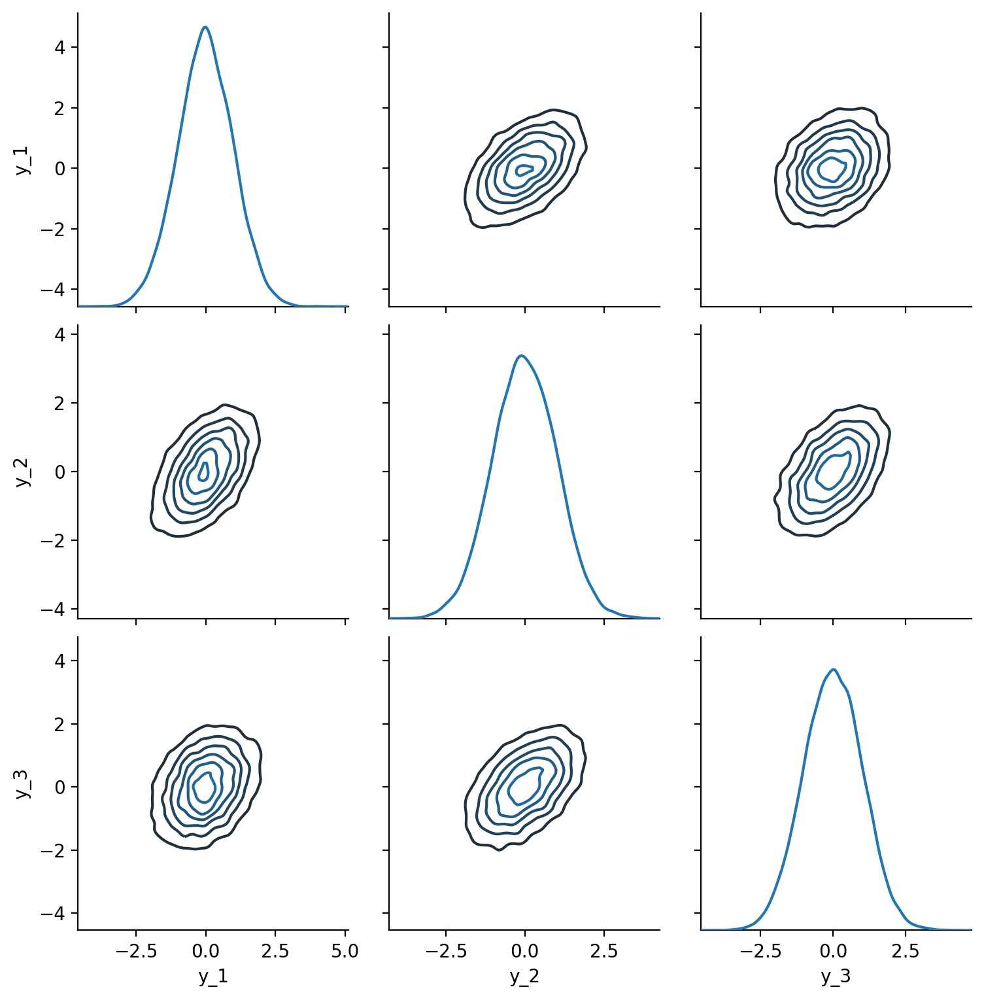

In [81]:
multi_variable_dict = {
    "y_1":results_model_multi_normal['wyjscie'][:,0],
    "y_2":results_model_multi_normal['wyjscie'][:,1],
    "y_3":results_model_multi_normal['wyjscie'][:,2]
}

multi_variable_dataFrame = pd.DataFrame(multi_variable_dict)

Visualization = sn.PairGrid(multi_variable_dataFrame)
Visualization.map_diag(sn.kdeplot)
Visualization.map_offdiag(sn.kdeplot, n_levels=6)

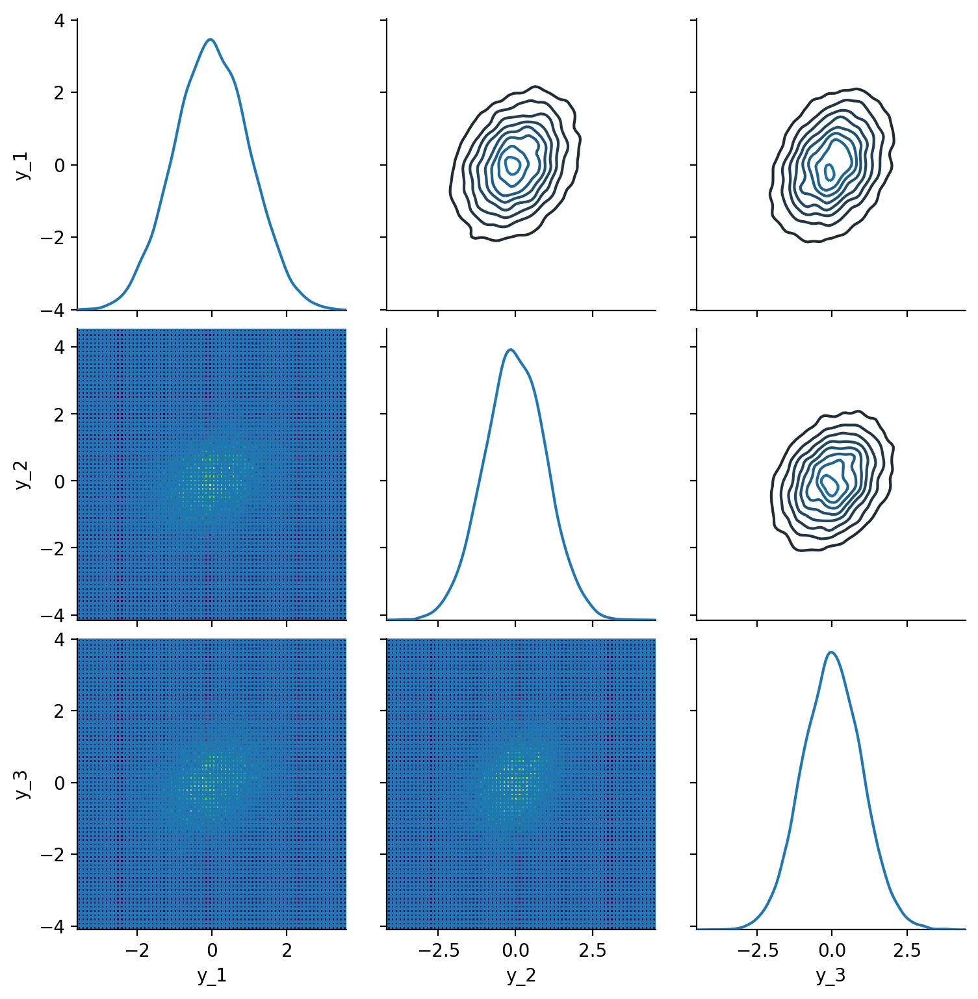

In [82]:
# Teraz sobie pozgadujemy:
# Musi byc dict bo takie sa wymagania stana, tak musi byc i tyle:
mean=[0, 0, 0]
cov=[(1, 0.3, 0.3), (0.3, 1, 0.3), (0.3, 0.3, 1)]
N = len(cov)
data = {'N':N, 'mu':mean, 'Sigma':cov}

numberOfIterations = 10000

# No i tutaj robimy sobie sampling, zeby zobaczyc jakie dostaniemy wyniki
sampling_data = model_N_multi_normal.sampling(data = data, seed = 11062020, iter = numberOfIterations)

# Wyciagamy dane:
results_model_multi_normal = sampling_data.extract()

multi_variable_dict = {
    "y_1":results_model_multi_normal['wyjscie'][:,0],
    "y_2":results_model_multi_normal['wyjscie'][:,1],
    "y_3":results_model_multi_normal['wyjscie'][:,2]
}

multi_variable_dataFrame = pd.DataFrame(multi_variable_dict)

Visualization = sn.PairGrid(multi_variable_dataFrame)
Visualization.map_diag(sn.kdeplot)
Visualization.map_upper(sn.kdeplot, n_level=6)
Visualization.map_lower(plt.hist2d, bins=70)

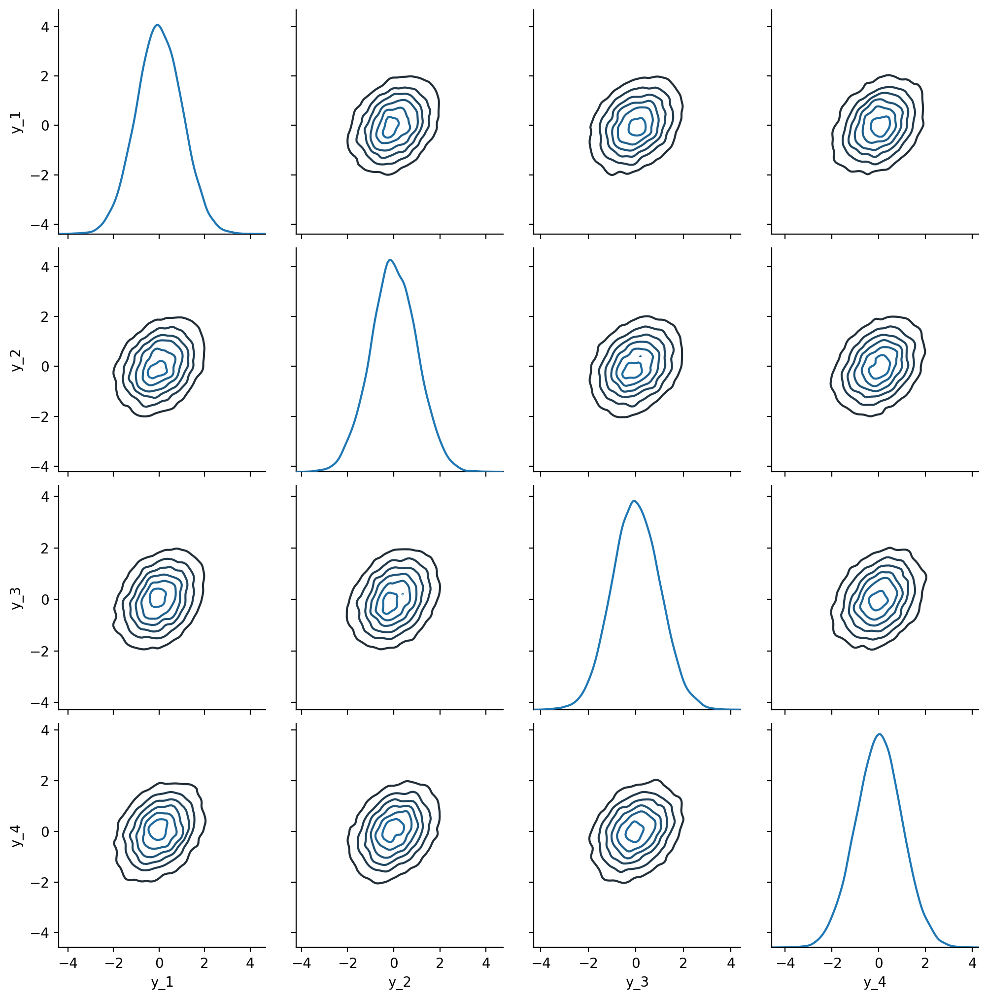

In [83]:
# Teraz sobie pozgadujemy:
# Musi byc dict bo takie sa wymagania stana, tak musi byc i tyle:
mean=[0, 0, 0, 0]
cov=[(1, 0.3, 0.3, 0.3), (0.3, 1, 0.3, 0.3), (0.3, 0.3, 1, 0.3), (0.3, 0.3, 0.3, 1)]
N = len(cov)
data = {'N':N, 'mu':mean, 'Sigma':cov}

numberOfIterations = 10000

# No i tutaj robimy sobie sampling, zeby zobaczyc jakie dostaniemy wyniki
sampling_data = model_N_multi_normal.sampling(data = data, seed = 11062020, iter = numberOfIterations)

# Wyciagamy dane:
results_model_multi_normal = sampling_data.extract()

multi_variable_dict = {
    "y_1":results_model_multi_normal['wyjscie'][:,0],
    "y_2":results_model_multi_normal['wyjscie'][:,1],
    "y_3":results_model_multi_normal['wyjscie'][:,2],
    "y_4":results_model_multi_normal['wyjscie'][:,3]
}

multi_variable_dataFrame = pd.DataFrame(multi_variable_dict)

Visualization = sn.PairGrid(multi_variable_dataFrame)
Visualization.map_diag(sn.kdeplot)
Visualization.map_offdiag(sn.kdeplot, n_levels=6)